# NYC Airbnb Analysis

# 1. Data Preprocessing

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
import numpy as np

In [2]:
df = pd.read_csv("listings.csv")
df.head()

,id,listing_url,scrape_id,last_scraped,source,name,description,neighborhood_overview,picture_url,host_id,...,review_scores_communication,review_scores_location,review_scores_value,license,instant_bookable,calculated_host_listings_count,calculated_host_listings_count_entire_homes,calculated_host_listings_count_private_rooms,calculated_host_listings_count_shared_rooms,reviews_per_month
0,39572,https://www.airbnb.com/rooms/39572,20250103033441,2025-01-03,city scrape,1 br in a 2 br apt (Midtown West),NaN,NaN,https://a0.muscache.com/pictures/fd1bffd9-ccf8...,169927,...,5.00,4.98,4.86,NaN,f,2,1,1,0,0.25
1,39593,https://www.airbnb.com/rooms/39593,20250103033441,2025-01-03,city scrape,A lovely room w/ a Manhattan view,"A private, furnished large room to rent Jan/F...","Nate Silver called this super safe, clean, qui...",https://a0.muscache.com/pictures/0b9110f7-3b24...,110506,...,4.96,4.79,4.93,NaN,f,1,0,1,0,0.20
2,39704,https://www.airbnb.com/rooms/39704,20250103033441,2025-01-03,previous scrape,"Private, Large & Sunny 1BR w/W&D",It's a No Brainer:<br />•Terrific Space For Le...,The Neighborhood<br />• Rich History <br />• B...,https://a0.muscache.com/pictures/0bc4e8a4-c047...,170510,...,4.92,4.38,4.72,NaN,f,2,2,0,0,1.93
3,42300,https://www.airbnb.com/rooms/42300,20250103033441,2025-01-03,city scrape,Beautiful Lower East Side Loft,Architect-owned loft is a corner unit in a bea...,"The apartment is in the border of Soho, LES an...",https://a0.muscache.com/pictures/0e285e13-ee14...,184755,...,4.87,4.57,4.62,NaN,f,1,1,0,0,0.40
4,42729,https://www.airbnb.com/rooms/42729,20250103033441,2025-01-03,city scrape,@HouseOnHenrySt - Private 2nd bedroom w/shared...,NaN,"Lovely old Brooklyn neighborhood, with brick/b...",https://a0.muscache.com/pictures/925fe213-f5e1...,11481,...,4.73,4.58,4.64,NaN,f,4,1,3,0,1.26


In [3]:
df.shape

(37784, 75)

In [4]:
df.columns

Index(['id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'name',
       'description', 'neighborhood_overview', 'picture_url', 'host_id',
       'host_url', 'host_name', 'host_since', 'host_location', 'host_about',
       'host_response_time', 'host_response_rate', 'host_acceptance_rate',
       'host_is_superhost', 'host_thumbnail_url', 'host_picture_url',
       'host_neighbourhood', 'host_listings_count',
       'host_total_listings_count', 'host_verifications',
       'host_has_profile_pic', 'host_identity_verified', 'neighbourhood',
       'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'latitude',
       'longitude', 'property_type', 'room_type', 'accommodates', 'bathrooms',
       'bathrooms_text', 'bedrooms', 'beds', 'amenities', 'price',
       'minimum_nights', 'maximum_nights', 'minimum_minimum_nights',
       'maximum_minimum_nights', 'minimum_maximum_nights',
       'maximum_maximum_nights', 'minimum_nights_avg_ntm',
       'maximum_nights_avg_ntm', 'ca

In [5]:
columns_to_drop = [
    'id', 'listing_url', 'scrape_id', 'last_scraped', 'source', 'picture_url', 
    'host_id', 'host_url', 'host_name', 'host_since', 'host_location', 'host_about', 
    'host_thumbnail_url', 'host_picture_url', 'calendar_updated', 'calendar_last_scraped', 
    'license', 'host_response_time', 'host_response_rate', 'host_acceptance_rate', 
    'host_verifications', 'host_has_profile_pic', 'host_identity_verified', 
    'neighbourhood_cleansed', 'neighbourhood_group_cleansed', 'first_review', 'last_review', 
    'calculated_host_listings_count', 'calculated_host_listings_count_entire_homes', 
    'calculated_host_listings_count_private_rooms', 'calculated_host_listings_count_shared_rooms',
    'neighborhood_overview', 'neighbourhood', 'host_neighbourhood', 'has_availability'
]

df_filtered = df.drop(columns=columns_to_drop)

print(f"New dataset shape: {df_filtered.shape}")
print("Selected columns:")
print(df_filtered.columns)

New dataset shape: (37784, 40)
Selected columns:
Index(['name', 'description', 'host_is_superhost', 'host_listings_count',
       'host_total_listings_count', 'latitude', 'longitude', 'property_type',
       'room_type', 'accommodates', 'bathrooms', 'bathrooms_text', 'bedrooms',
       'beds', 'amenities', 'price', 'minimum_nights', 'maximum_nights',
       'minimum_minimum_nights', 'maximum_minimum_nights',
       'minimum_maximum_nights', 'maximum_maximum_nights',
       'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'availability_30',
       'availability_60', 'availability_90', 'availability_365',
       'number_of_reviews', 'number_of_reviews_ltm', 'number_of_reviews_l30d',
       'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value', 'instant_bookable', 'reviews_per_month'],
      dtype='object')


Missing Values (%):
beds                           39.524667
price                          39.209718
bathrooms                      39.167372
review_scores_location         31.523925
review_scores_value            31.521279
review_scores_checkin          31.515986
review_scores_accuracy         31.505399
review_scores_communication    31.492166
review_scores_cleanliness      31.478933
reviews_per_month              31.473640
review_scores_rating           31.473640
bedrooms                       15.374232
description                     2.575164
host_is_superhost               1.114228
bathrooms_text                  0.084692
host_total_listings_count       0.015880
host_listings_count             0.015880
name                            0.005293
maximum_nights_avg_ntm          0.005293
minimum_nights_avg_ntm          0.005293
maximum_maximum_nights          0.005293
maximum_minimum_nights          0.005293
minimum_minimum_nights          0.005293
minimum_maximum_nights          0.005

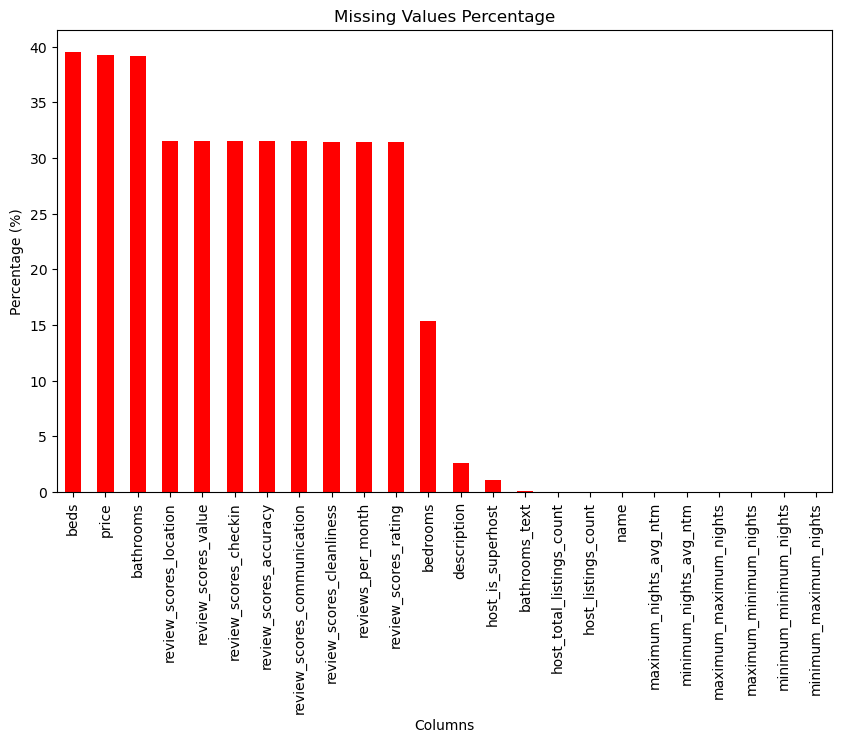

In [6]:
missing_values = df_filtered.isnull().sum() / len(df_filtered) * 100
missing_values = missing_values[missing_values > 0].sort_values(ascending=False)

print("Missing Values (%):")
print(missing_values)

plt.figure(figsize=(10, 6))
missing_values.plot(kind="bar", color="red")
plt.title("Missing Values Percentage")
plt.ylabel("Percentage (%)")
plt.xlabel("Columns")
plt.xticks(rotation=90)
plt.show()

In [13]:
# Create a new copy to avoid FutureWarning errors
df_filtered = df_filtered.copy()

# Fill missing numerical values with the mean
df_filtered = df_filtered.assign(
    beds=df_filtered['beds'].fillna(df_filtered['beds'].mean()),
    bathrooms=df_filtered['bathrooms'].fillna(df_filtered['bathrooms'].mean()),
    bedrooms=df_filtered['bedrooms'].fillna(df_filtered['bedrooms'].mean())
)

# Fill missing review scores with the median
review_columns = [
    'review_scores_rating', 'review_scores_accuracy', 'review_scores_cleanliness',
    'review_scores_checkin', 'review_scores_communication', 'review_scores_location', 'review_scores_value'
]
df_filtered[review_columns] = df_filtered[review_columns].apply(lambda x: x.fillna(x.median()))

# Fill missing values in reviews_per_month with 0
df_filtered = df_filtered.assign(reviews_per_month=df_filtered['reviews_per_month'].fillna(0))

# Fill missing values in description and host_is_superhost with "Unknown"
df_filtered = df_filtered.assign(
    description=df_filtered['description'].fillna("Unknown"),
    host_is_superhost=df_filtered['host_is_superhost'].fillna("Unknown")
)

# Extract only the numeric values from bathrooms_text
df_filtered['bathrooms_text'] = df_filtered['bathrooms_text'].str.extract(r'(\d+)').astype(float)
df_filtered = df_filtered.assign(bathrooms_text=df_filtered['bathrooms_text'].fillna(df_filtered['bathrooms_text'].mean()))

# Drop rows where the price column is missing
df_filtered = df_filtered.dropna(subset=['price'])

# Fill missing values in host_listings_count and host_total_listings_count with the mean
df_filtered = df_filtered.assign(
    host_listings_count=df_filtered['host_listings_count'].fillna(df_filtered['host_listings_count'].mean()),
    host_total_listings_count=df_filtered['host_total_listings_count'].fillna(df_filtered['host_total_listings_count'].mean())
)

# Final check
print("New dataset shape after handling missing values:", df_filtered.shape)
print("Total remaining missing values:", df_filtered.isnull().sum().sum())  # If 0, no missing values remain!

New dataset shape after handling missing values: (22969, 40)
Total remaining missing values: 0


# 2. Feature Engineering

## 2.1 Converting the Price Column to Numeric + Log Transformation

In [17]:
# Remove special characters like "$" and "," from the price column and convert it to numeric
df_filtered['price'] = df_filtered['price'].replace(r'[\$,]', '', regex=True).astype(float)

# Normalize the price column using log transformation (log(1 + price))
df_filtered['price'] = np.log1p(df_filtered['price'])

# Verify the transformation
print("Data type of the price column:", df_filtered['price'].dtype)
print(df_filtered['price'].head())

Data type of the price column: float64
0    4.941642
1    4.369448
3    6.621406
4    5.225747
5    5.111988
Name: price, dtype: float64


## 2.2 Latitude & Longitude Clustering

In [22]:
from sklearn.cluster import KMeans
import numpy as np

coords = df_filtered[['latitude', 'longitude']].dropna().to_numpy()

# Create a clustering model (define 10 neighborhood clusters)
kmeans = KMeans(n_clusters=10, random_state=42, n_init=10)

# Predict clusters and add them to the dataframe
mask = ~df_filtered[['latitude', 'longitude']].isna().any(axis=1)  # Select non-missing values
df_filtered.loc[mask, 'neighbourhood_cluster'] = kmeans.fit_predict(coords)
df_filtered.loc[df_filtered['neighbourhood_cluster'].isna(), 'neighbourhood_cluster'] = -1

print("New neighborhood clusters added?")
print(df_filtered[['neighbourhood_cluster']].head())

New neighborhood clusters added?
   neighbourhood_cluster
0                    1.0
1                    0.0
3                    8.0
4                    8.0
5                    1.0


In [24]:
df_filtered['neighbourhood_cluster'].value_counts()

neighbourhood_cluster
1.0    5048
9.0    3838
7.0    3136
8.0    2927
3.0    2362
2.0    1776
0.0    1663
5.0    1075
4.0     831
6.0     313
Name: count, dtype: int64

In [26]:
df_filtered.groupby('neighbourhood_cluster')['price'].mean().sort_values()

neighbourhood_cluster
4.0    4.492193
0.0    4.547752
3.0    4.640852
6.0    4.670610
2.0    4.722983
5.0    4.735749
7.0    4.779692
9.0    4.844547
1.0    5.303541
8.0    5.374247
Name: price, dtype: float64

In [ ]:
plt.figure(figsize=(10, 8), dpi=200)
plt.gcf().patch.set_facecolor('white')
sns.heatmap(data.isnull(), cbar=False, cmap="viridis")
plt.title("Missing Data Heatmap", fontsize=14)
plt.savefig("images/missing_data.png", dpi=250, bbox_inches='tight')  
plt.show()

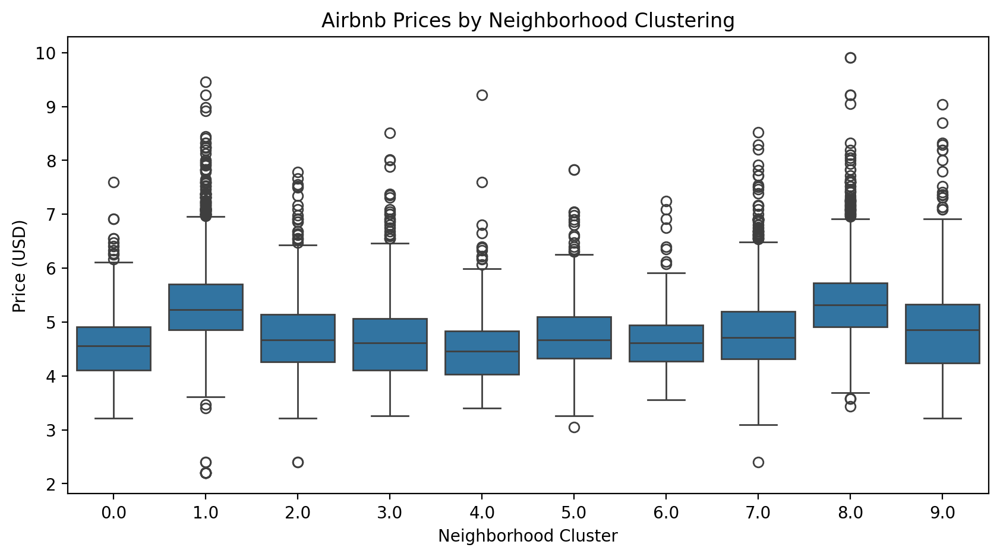

In [28]:
plt.figure(figsize=(10, 5), dpi=200)
plt.gcf().patch.set_facecolor('white')
sns.boxplot(x=df_filtered['neighbourhood_cluster'], y=df_filtered['price'])
plt.xlabel("Neighborhood Cluster")
plt.ylabel("Price (USD)")
plt.title("Airbnb Prices by Neighborhood Clustering")
plt.savefig("images/neighborhood.png", dpi=250, bbox_inches='tight')  
plt.show()

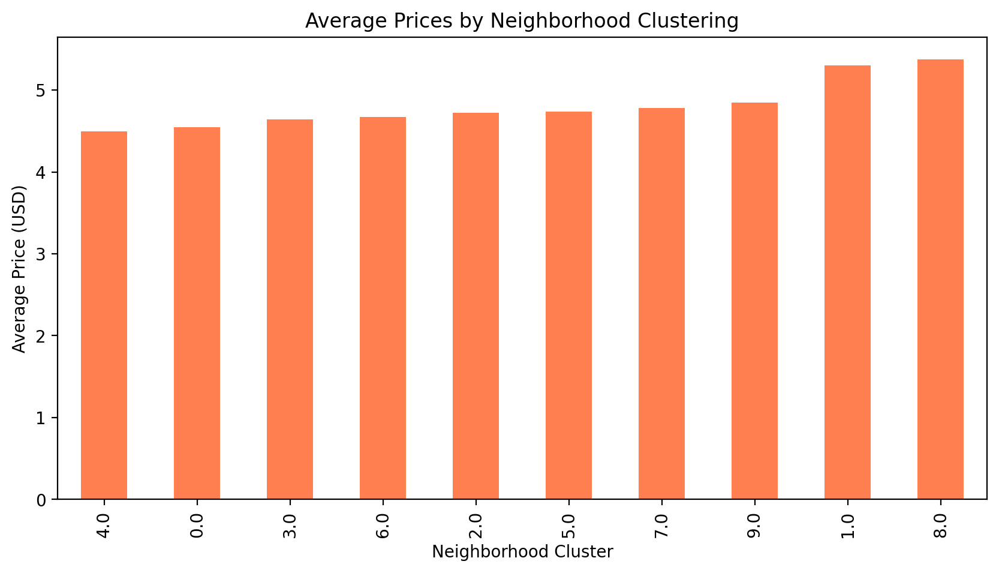

In [30]:
plt.figure(figsize=(10, 5), dpi=200)
plt.gcf().patch.set_facecolor('white')
df_filtered.groupby('neighbourhood_cluster')['price'].mean().sort_values().plot(kind='bar', color='coral')
plt.xlabel("Neighborhood Cluster")
plt.ylabel("Average Price (USD)")
plt.title("Average Prices by Neighborhood Clustering")
plt.savefig("images/average-prices.png", dpi=250, bbox_inches='tight')  
plt.show()

### Create an interactive Airbnb clustering map in an HTML file

In [35]:
import folium
import numpy as np
from folium.plugins import MarkerCluster

# Get the average location for the map center
map_center = [df_filtered['latitude'].mean(), df_filtered['longitude'].mean()]
m = folium.Map(location=map_center, zoom_start=11)

colors = ['red', 'blue', 'green', 'purple', 'orange', 'darkred', 'lightred', 
          'beige', 'darkblue', 'darkgreen']

marker_cluster = MarkerCluster().add_to(m)

# Add points for each cluster
for idx, row in df_filtered.iterrows():
    if not np.isnan(row['latitude']) and not np.isnan(row['longitude']):
        cluster_id = int(row['neighbourhood_cluster'])  # Cluster ID
        folium.Marker(
            location=[row['latitude'], row['longitude']],
            popup=f"Cluster: {cluster_id}, Price: {row['price']}$",
            icon=folium.Icon(color=colors[cluster_id % len(colors)])  # Cycle through colors
        ).add_to(marker_cluster)

m.save("airbnb_clusters.html")
m

## 2.3 Encoding Categorical Variables

In [34]:
categorical_columns = df_filtered.select_dtypes(include=['object']).columns
print("Categorical Columns:", categorical_columns)

Categorical Columns: Index(['name', 'description', 'host_is_superhost', 'property_type',
       'room_type', 'amenities', 'instant_bookable'],
      dtype='object')


In [36]:
categorical_ohe = ['property_type', 'room_type', 'instant_bookable']
df_filtered = pd.get_dummies(df_filtered, columns=categorical_ohe, drop_first=True)
df_filtered['host_is_superhost'] = df_filtered['host_is_superhost'].map({'t': 1, 'f': 0, 'Unknown': 0})
df_filtered.drop(columns=['name', 'description', 'amenities'], inplace=True, errors='ignore')

print("Updated dataset shape:", df_filtered.shape)
print("Remaining columns:")
print(df_filtered.columns)

Updated dataset shape: (22969, 93)
Remaining columns:
Index(['host_is_superhost', 'host_listings_count', 'host_total_listings_count',
       'latitude', 'longitude', 'accommodates', 'bathrooms', 'bathrooms_text',
       'bedrooms', 'beds', 'price', 'minimum_nights', 'maximum_nights',
       'minimum_minimum_nights', 'maximum_minimum_nights',
       'minimum_maximum_nights', 'maximum_maximum_nights',
       'minimum_nights_avg_ntm', 'maximum_nights_avg_ntm', 'availability_30',
       'availability_60', 'availability_90', 'availability_365',
       'number_of_reviews', 'number_of_reviews_ltm', 'number_of_reviews_l30d',
       'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value', 'reviews_per_month', 'neighbourhood_cluster',
       'property_type_Boat', 'property_type_Camper/RV',
       'property_type_Casa particular', 'property_type_Entire

# 3. Train-Test Split

In [38]:
from sklearn.model_selection import train_test_split

# Remove outliers by filtering prices above a threshold
df_filtered = df_filtered[df_filtered['price'] <= 10000]

# Define features (X) and target variable (y)
X = df_filtered.drop(columns=['price']) 
y = df_filtered['price'] 

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Print dataset shapes
print("Training set shape:", X_train.shape)
print("Test set shape:", X_test.shape)

Training set shape: (18375, 92)
Test set shape: (4594, 92)


In [40]:
# Get the 1st and 99th percentile values
lower_bound = np.percentile(y_train, 1)
upper_bound = np.percentile(y_train, 99)

# Remove outliers
mask_train = (y_train >= lower_bound) & (y_train <= upper_bound)
mask_test = (y_test >= lower_bound) & (y_test <= upper_bound)

# Filter using the indices of `mask_train` and `mask_test`
X_train_cleaned = X_train.loc[mask_train.index.intersection(X_train.index)]
y_train_cleaned = y_train.loc[mask_train.index.intersection(y_train.index)]

X_test_cleaned = X_test.loc[mask_test.index.intersection(X_test.index)]
y_test_cleaned = y_test.loc[mask_test.index.intersection(y_test.index)]

# Check the results
print("X_train size after removing outliers:", X_train_cleaned.shape)
print("y_train size after removing outliers:", y_train_cleaned.shape)

X_train size after removing outliers: (18375, 92)
y_train size after removing outliers: (18375,)


## Yeni Ölçekleme

In [42]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train_cleaned)
X_test_scaled = scaler.transform(X_test_cleaned)

# Convert back to DataFrame and retain original indices
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train_cleaned.columns, index=X_train_cleaned.index)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=X_test_cleaned.columns, index=X_test_cleaned.index)

In [44]:
valid_indices = X_train_scaled.index.intersection(y_train_cleaned.index)

# Filter y_train based on the same indices
y_train_filtered = y_train_cleaned.loc[valid_indices]

valid_indices_test = X_test_scaled.index.intersection(y_test_cleaned.index)
y_test_filtered = y_test_cleaned.loc[valid_indices_test]

print("New X_train_scaled size:", X_train_scaled.shape)
print("New y_train_filtered size:", y_train_filtered.shape)
print("New X_test_scaled size:", X_test_scaled.shape)
print("New y_test_filtered size:", y_test_filtered.shape)

New X_train_scaled size: (18375, 92)
New y_train_filtered size: (18375,)
New X_test_scaled size: (4594, 92)
New y_test_filtered size: (4594,)


# Train the Model

In [47]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

model = keras.Sequential([
    layers.Input(shape=(X_train_scaled.shape[1],)),  # Input layer
    layers.Dense(128, activation="relu"),
    layers.Dropout(0.3),  # Adding dropout to prevent overfitting
    layers.Dense(64, activation="relu"),
    layers.Dropout(0.3),
    layers.Dense(32, activation="relu"),
    layers.Dropout(0.3),
    layers.Dense(1)  # Output layer (No activation function as this is a regression problem)
])

model.compile(optimizer="adam", loss="mse", metrics=["mae"])

early_stopping = keras.callbacks.EarlyStopping(
    monitor="val_loss",
    patience=15,  # Stops training if no improvement for 15 epochs
    restore_best_weights=True,
    verbose=1
)

history = model.fit(
    X_train_scaled, y_train_filtered,
    validation_data=(X_test_scaled, y_test_filtered),
    epochs=100,
    batch_size=16,  # Small batch size for more stable learning
    callbacks=[early_stopping],
    verbose=1
)

Epoch 1/100
1149/1149 ━━━━━━━━━━━━━━━━━━━━ 4s 2ms/step - loss: 3.0882 - mae: 1.3149 - val_loss: 0.4811 - val_mae: 0.5322
Epoch 2/100
1149/1149 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 1.0095 - mae: 0.7891 - val_loss: 0.2904 - val_mae: 0.3972
Epoch 3/100
1149/1149 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.7602 - mae: 0.6826 - val_loss: 0.2840 - val_mae: 0.4042
Epoch 4/100
1149/1149 ━━━━━━━━━━━━━━━━━━━━ 2s 2ms/step - loss: 0.6582 - mae: 0.6386 - val_loss: 0.2769 - val_mae: 0.3834
Epoch 5/100
1149/1149 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.5496 - mae: 0.5731 - val_loss: 0.2599 - val_mae: 0.3701
Epoch 6/100
1149/1149 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.4619 - mae: 0.5262 - val_loss: 0.2444 - val_mae: 0.3595
Epoch 7/100
1149/1149 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.4247 - mae: 0.4999 - val_loss: 0.2859 - val_mae: 0.3788
Epoch 8/100
1149/1149 ━━━━━━━━━━━━━━━━━━━━ 3s 2ms/step - loss: 0.3865 - mae: 0.4725 - val_loss: 0.2802 - val_mae: 0.3833
Epoch 9/100
1149/1149 ━━━━━━━━━━

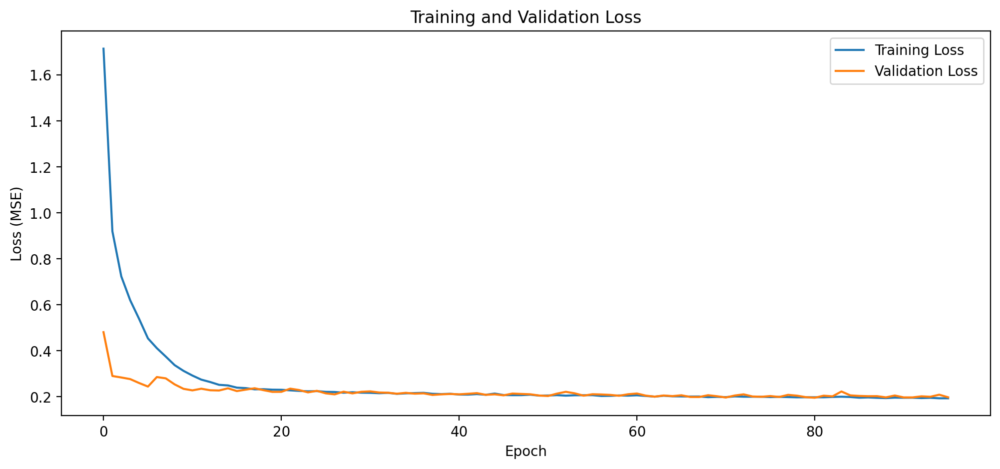

In [48]:
plt.figure(figsize=(12, 5), dpi=200)
plt.gcf().patch.set_facecolor('white')
plt.plot(history.history["loss"], label="Training Loss")
plt.plot(history.history["val_loss"], label="Validation Loss")
plt.xlabel("Epoch")
plt.ylabel("Loss (MSE)")
plt.legend()
plt.title("Training and Validation Loss")
plt.savefig("images/training-validation.png", dpi=250, bbox_inches='tight')  
plt.show()

In [49]:
# Evaluate the model performance on the test set
test_loss, test_mae = model.evaluate(X_test_scaled, y_test_filtered)
print(f"Test Set Loss (MSE): {test_loss:.4f}")
print(f"Test Set Mean Absolute Error (MAE): {test_mae:.4f}")

144/144 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step - loss: 0.1918 - mae: 0.3077
Test Set Loss (MSE): 0.1958
Test Set Mean Absolute Error (MAE): 0.3131


In [50]:
# Generate predictions
y_pred = model.predict(X_test_scaled)

comparison_df = pd.DataFrame({
    "Actual Price": y_test_filtered.values,
    "Predicted Price": y_pred.flatten()  # Flatten the array
})

print(comparison_df.head())

144/144 ━━━━━━━━━━━━━━━━━━━━ 0s 1ms/step  
   Actual Price  Predicted Price
0      4.127134         4.650425
1      4.779123         4.294782
2      4.912655         6.203260
3      5.043425         5.067581
4      5.831882         5.790090


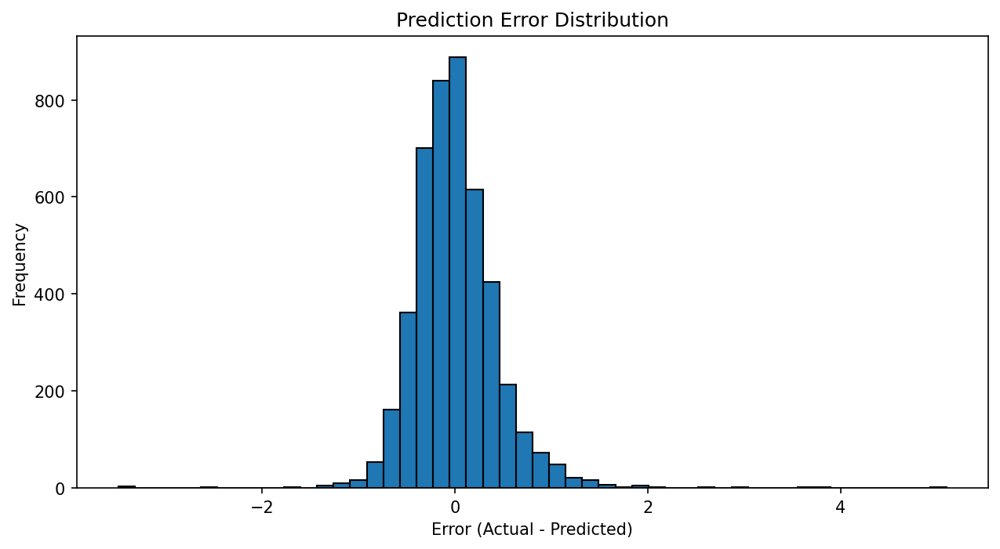

In [51]:
error = comparison_df["Actual Price"] - comparison_df["Predicted Price"]

plt.figure(figsize=(10, 5), dpi=150)
plt.gcf().patch.set_facecolor('white')
plt.hist(error, bins=50, edgecolor="black")
plt.xlabel("Error (Actual - Predicted)")
plt.ylabel("Frequency")
plt.title("Prediction Error Distribution")
plt.savefig("images/pred-error.png", dpi=250, bbox_inches='tight') 
plt.show()